In [ ]:


from itertools import product
from datasets import load_dataset,load_from_disk
import config
import os
import pandas as pd
import util
import torch
import plotting
from scipy.stats import power_divergence

import config
from itertools import product



In [ ]:
import os
import pandas as pd
import torch
from itertools import product
from tqdm import tqdm
from concurrent.futures import ThreadPoolExecutor, ProcessPoolExecutor, as_completed
import threading
from multiprocessing import Manager
from scipy.spatial.distance import jensenshannon
from scipy.stats import entropy
stats_lock = threading.Lock()


manager = Manager()
dataset_cache = manager.dict()
df_cache = manager.dict()
stats = manager.list()  

def get_cached_dataset(dataset_name):
    if dataset_name not in dataset_cache:
        print(f"[Dataset] Loading: {dataset_name}")
        dataset_cache[dataset_name] = load_dataset(dataset_name)["train"].select_columns("stage")
    return dataset_cache[dataset_name]

def get_prepared_df(dataset_name, model_type):
    cache_key = (dataset_name, model_type)

    if cache_key not in df_cache:
        print(f"[DataFrame] Preparing for: {dataset_name} / {model_type}")
        
        dataset = get_cached_dataset(dataset_name)
        model_name = dataset_name + "_" + model_type + "_random"
        
        influence_output_dir = os.path.join(
            "./influence_mean_normalized",
            os.path.basename(model_name),
            "_".join([(os.path.basename(dataset_name) + "_" + "train[0%:100%]")] * 2),
        )
        
        df = pd.DataFrame({
            int(result_checkpoint.replace("checkpoint-", "")): torch.load(
                os.path.join(influence_output_dir, result_checkpoint),
                weights_only=True,
                map_location="cpu"
            ).numpy().flatten()
            for result_checkpoint in os.listdir(influence_output_dir)
        })

        df = df.reindex(sorted(df.columns), axis=1)
        df["stage"] = dataset.to_pandas()

        df_cache[cache_key] = df
        print(f"[DataFrame] Cached for: {dataset_name} / {model_type}")
    return df_cache[cache_key]


all_combinations = []

for model_type in config.model_types: 
    curricula = [model_type + c for c in config.influence_curricula] + config.baseline_curricula
    for curriculum in curricula:
        for dataset in config.datasets:
            all_combinations.append((dataset, model_type, curriculum))
print(all_combinations)

def process_combination(combination):

    dataset_name, model_type, curriculum_a_name = combination
    local_stats = []
    
    # try:
    df = get_prepared_df(dataset_name, model_type)

    epsilon = 1e-100
    bins = 1000

    curriculum_a = util.get_curriculum(dataset_name, curriculum_a_name)

    examples_a = df.iloc[torch.cat(curriculum_a).flatten()]
    
    all_stages = examples_a["stage"].unique()
    
    
    bin_size = len(examples_a) // bins

    chunks = [
        examples_a["stage"][i:i+bin_size]
        for i in range(0, len(examples_a), bin_size) if i + bin_size < len(examples_a)
    ]

    for idx, a in enumerate(chunks):
        d = a.value_counts().reindex(all_stages, fill_value=epsilon)
        d["chunk"] = idx
        d["curriculum"] = curriculum_a_name
        d["dataset"] = dataset_name
        d["model_type"] = model_type
        local_stats.append(d)

    # except Exception as e:
    #     print(f"[Error] Skipping: {dataset_name}, {model_type}, {curriculum_a_name}, {curriculum_b_name}")
    #     print("Reason:", str(e))
    print("local_stats",local_stats)
    with stats_lock:
        stats.extend(local_stats)


import random
from itertools import chain, zip_longest
from collections import defaultdict


first_batch = all_combinations[:3]
remaining_batch = all_combinations[3:]



with ThreadPoolExecutor(max_workers=3) as executor:
    futures = [executor.submit(process_combination, c) for c in first_batch]
    for _ in tqdm(as_completed(futures), total=len(futures), desc="Processing (3 workers)") :
        pass
print(stats)

print(len(stats))
with ProcessPoolExecutor(max_workers=32) as executor:
    futures = [executor.submit(process_combination, c) for c in remaining_batch]
    for _ in tqdm(as_completed(futures), total=len(futures), desc="Processing (64 workers)") :
        pass
print(len(stats))





[('loris3/babylm_2024_10m_curriculum', 'llama', 'llama_influence_epoch_repetition.pt'), ('loris3/stratified_equitoken_10m_curriculum', 'llama', 'llama_influence_epoch_repetition.pt'), ('loris3/stratified_10m_curriculum', 'llama', 'llama_influence_epoch_repetition.pt'), ('loris3/babylm_2024_10m_curriculum', 'llama', 'llama_influence_incr_bins_dirac.pt'), ('loris3/stratified_equitoken_10m_curriculum', 'llama', 'llama_influence_incr_bins_dirac.pt'), ('loris3/stratified_10m_curriculum', 'llama', 'llama_influence_incr_bins_dirac.pt'), ('loris3/babylm_2024_10m_curriculum', 'llama', 'llama_influence_decr_bins_dirac.pt'), ('loris3/stratified_equitoken_10m_curriculum', 'llama', 'llama_influence_decr_bins_dirac.pt'), ('loris3/stratified_10m_curriculum', 'llama', 'llama_influence_decr_bins_dirac.pt'), ('loris3/babylm_2024_10m_curriculum', 'llama', 'llama_influence_incr_bins_lognorm.pt'), ('loris3/stratified_equitoken_10m_curriculum', 'llama', 'llama_influence_incr_bins_lognorm.pt'), ('loris3/stra

Processing (3 workers):   0%|          | 0/3 [00:00<?, ?it/s]

[DataFrame] Preparing for: loris3/babylm_2024_10m_curriculum / llama
[Dataset] Loading: loris3/babylm_2024_10m_curriculum
[DataFrame] Preparing for: loris3/stratified_equitoken_10m_curriculum / llama
[Dataset] Loading: loris3/stratified_equitoken_10m_curriculum
[DataFrame] Preparing for: loris3/stratified_10m_curriculum / llama
[Dataset] Loading: loris3/stratified_10m_curriculum
[DataFrame] Cached for: loris3/babylm_2024_10m_curriculum / llama
[DataFrame] Cached for: loris3/stratified_equitoken_10m_curriculum / llama
local_stats [stage
C3: Dialogue                                                      738.0
C5: Written English                                               208.0
C2: Children's Books                                               25.0
C4: Educational                                                    29.0
C1: Child Directed Speech                                           0.0
chunk                                                               0.0
curriculum                

Processing (3 workers):  33%|███▎      | 1/3 [00:07<00:14,  7.23s/it]

[DataFrame] Cached for: loris3/stratified_10m_curriculum / llama
local_stats local_stats [stage
C1: Child Directed Speech                                17160.0
C3: Scripted Dialogue                                        0.0
C2: Unscripted Dialogue                                      0.0
C4: Wiki                                                     0.0
C5: Written English                                          0.0
chunk                                                        0.0
curriculum                   llama_influence_epoch_repetition.pt
dataset                        loris3/babylm_2024_10m_curriculum
model_type                                                 llama
Name: count, dtype: object, stage
C1: Child Directed Speech                                17160.0
C3: Scripted Dialogue                                        0.0
C2: Unscripted Dialogue                                      0.0
C4: Wiki                                                     0.0
C5: Written English      

Processing (3 workers): 100%|██████████| 3/3 [00:16<00:00,  5.35s/it]
IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

Processing (64 workers):   0%|          | 0/75 [00:00<?, ?it/s]

local_stats [stage
C1: Child Directed Speech                                           281
C2: Children's Books                                                 98
C3: Dialogue                                                         48
C4: Educational                                                     462
C5: Written English                                                 111
chunk                                                                 0
curriculum                           llama_influence_incr_bins_dirac.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                        llama
Name: count, dtype: object, stage
C1: Child Directed Speech                                           340
C2: Children's Books                                                121
C3: Dialogue                                                         50
C4: Educational                                                     362
C5: Written

Processing (64 workers):   1%|▏         | 1/75 [00:06<08:13,  6.67s/it]

local_stats local_stats local_stats [stage
C1: Child Directed Speech                                           281
C2: Children's Books                                                 98
C3: Dialogue                                                         48
C4: Educational                                                     462
C5: Written English                                                 111
chunk                                                                 0
curriculum                         llama_influence_incr_bins_lognorm.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                        llama
Name: count, dtype: object, stage
C1: Child Directed Speech                                           340
C2: Children's Books                                                121
C3: Dialogue                                                         50
C4: Educational                                            

Processing (64 workers):   3%|▎         | 2/75 [00:07<04:11,  3.45s/it]

 
local_stats 

Processing (64 workers):   4%|▍         | 3/75 [00:08<02:29,  2.08s/it]

local_stats 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




local_stats local_stats [stage
C5: Written English                                                 253
C3: Dialogue                                                        291
C2: Children's Books                                                193
C1: Child Directed Speech                                           113
C4: Educational                                                     150
chunk                                                                 0
curriculum                        llama_influence_top_50_cp_shuffled.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                        llama
Name: count, dtype: object, stage
C5: Written English                                                 248
C3: Dialogue                                                        264
C2: Children's Books                                                224
C1: Child Directed Speech                                           11

Processing (64 workers):   7%|▋         | 5/75 [00:10<01:39,  1.42s/it]

[DataFrame] Preparing for: loris3/stratified_equitoken_10m_curriculum / roberta[DataFrame] Preparing for: loris3/babylm_2024_10m_curriculum / roberta



Processing (64 workers):   9%|▉         | 7/75 [00:10<00:55,  1.22it/s]

[DataFrame] Preparing for: loris3/stratified_10m_curriculum / roberta


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[DataFrame] Preparing for: loris3/babylm_2024_10m_curriculum / roberta
local_stats [stage
C3: Dialogue                                               6307
C5: Written English                                        1249
C4: Educational                                            1713
C2: Children's Books                                        497
C1: Child Directed Speech                                   937
chunk                                                         0
curriculum                   llama_influence_incr_bins_dirac.pt
dataset                        loris3/stratified_10m_curriculum
model_type                                                llama
Name: count, dtype: object, stage
C3: Dialogue                                               5303
C5: Written English                                        1351
C4: Educational                                            1888
C2: Children's Books                                        767
C1: Child Directed Speech                   

Processing (64 workers):  12%|█▏        | 9/75 [00:11<00:54,  1.21it/s]

[stage
C3: Scripted Dialogue                                      6697
C2: Unscripted Dialogue                                    3638
C1: Child Directed Speech                                  1097
C4: Wiki                                                    133
C5: Written English                                         225
chunk                                                         0
curriculum                   llama_influence_incr_bins_dirac.pt
dataset                       loris3/babylm_2024_10m_curriculum
model_type                                                llama
Name: count, dtype: object, stage
C3: Scripted Dialogue                                      6898
C2: Unscripted Dialogue                                    2828
C1: Child Directed Speech                                   825
C4: Wiki                                                    534
C5: Written English                                         705
chunk                                                         1

Processing (64 workers):  13%|█▎        | 10/75 [00:12<00:45,  1.43it/s]IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




[stage
C3: Scripted Dialogue                                        6697
C2: Unscripted Dialogue                                      3638
C1: Child Directed Speech                                    1097
C4: Wiki                                                      133
C5: Written English                                           225
chunk                                                           0
curriculum                   llama_influence_incr_bins_lognorm.pt
dataset                         loris3/babylm_2024_10m_curriculum
model_type                                                  llama
Name: count, dtype: object, stage
C3: Scripted Dialogue                                        6898
C2: Unscripted Dialogue                                      2828
C1: Child Directed Speech                                     825
C4: Wiki                                                      534
C5: Written English                                           705
chunk                             

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




local_stats 

Processing (64 workers):  17%|█▋        | 13/75 [00:14<00:41,  1.50it/s]

[stage
C1: Child Directed Speech                                 6142
C3: Scripted Dialogue                                     4300
C2: Unscripted Dialogue                                   1206
C5: Written English                                         80
C4: Wiki                                                    62
chunk                                                        0
curriculum                                 mattr_increasing.pt
dataset                      loris3/babylm_2024_10m_curriculum
model_type                                               llama
Name: count, dtype: object, stage
C1: Child Directed Speech                                 5815
C3: Scripted Dialogue                                     4701
C2: Unscripted Dialogue                                    949
C5: Written English                                        209
C4: Wiki                                                   116
chunk                                                        1
curriculum    

Processing (64 workers):  19%|█▊        | 14/75 [00:14<00:30,  1.98it/s]

local_stats [stage
C4: Educational                                            1689
C3: Dialogue                                               3879
C1: Child Directed Speech                                  5007
C2: Children's Books                                         56
C5: Written English                                          72
chunk                                                         0
curriculum                   llama_influence_tracin_sandwich.pt
dataset                        loris3/stratified_10m_curriculum
model_type                                                llama
Name: count, dtype: object, stage
C4: Educational                                            1628
C3: Dialogue                                               3956
C1: Child Directed Speech                                  4981
C2: Children's Books                                         51
C5: Written English                                          87
chunk                                              

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



local_stats [stage
C2: Children's Books                                                301
C3: Dialogue                                                         92
C1: Child Directed Speech                                           148
C4: Educational                                                     148
C5: Written English                                                 311
chunk                                                                 0
curriculum                         roberta_influence_incr_bins_dirac.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                      roberta
Name: count, dtype: object, stage
C2: Children's Books                                                263
C3: Dialogue                                                        104
C1: Child Directed Speech                                           177
C4: Educational                                                     181
C5: Written

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



local_stats local_stats 

Processing (64 workers):  31%|███       | 23/75 [00:17<00:14,  3.63it/s]

[stage
C2: Children's Books                                                117
C3: Dialogue                                                        241
C5: Written English                                                 459
C4: Educational                                                     138
C1: Child Directed Speech                                            45
chunk                                                                 0
curriculum                         roberta_influence_decr_bins_dirac.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                      roberta
Name: count, dtype: object, stage
C2: Children's Books                                                167
C3: Dialogue                                                        220
C5: Written English                                                 349
C4: Educational                                                     187
C1: Child Directed Spee

Processing (64 workers):  35%|███▍      | 26/75 [00:18<00:09,  5.09it/s]

[stage
C1: Child Directed Speech                                  4560
C3: Dialogue                                               4895
C4: Educational                                            1129
C5: Written English                                          66
C2: Children's Books                                         53
chunk                                                         0
curriculum                   llama_influence_decr_bins_dirac.pt
dataset                        loris3/stratified_10m_curriculum
model_type                                                llama
Name: count, dtype: object, stage
C1: Child Directed Speech                                  3696
C3: Dialogue                                               4920
C4: Educational                                            1708
C5: Written English                                         210
C2: Children's Books                                        169
chunk                                                         1

Processing (64 workers):  36%|███▌      | 27/75 [00:18<00:11,  4.21it/s]

local_stats 

Processing (64 workers):  37%|███▋      | 28/75 [00:18<00:09,  4.79it/s]

[stage
C2: Children's Books                                                301
C3: Dialogue                                                         92
C1: Child Directed Speech                                           148
C4: Educational                                                     148
C5: Written English                                                 311
chunk                                                                 0
curriculum                       roberta_influence_incr_bins_lognorm.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                      roberta
Name: count, dtype: object, stage
C2: Children's Books                                                263
C3: Dialogue                                                        104
C1: Child Directed Speech                                           177
C4: Educational                                                     181
C5: Written English    

Processing (64 workers):  41%|████▏     | 31/75 [00:19<00:07,  6.13it/s]

local_stats 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



local_stats [stage
C3: Scripted Dialogue                                        7478
C1: Child Directed Speech                                    1259
C2: Unscripted Dialogue                                      1597
C5: Written English                                           580
C4: Wiki                                                      876
chunk                                                           0
curriculum                   roberta_influence_incr_bins_dirac.pt
dataset                         loris3/babylm_2024_10m_curriculum
model_type                                                roberta
Name: count, dtype: object, stage
C3: Scripted Dialogue                                        7427
C1: Child Directed Speech                                    1029
C2: Unscripted Dialogue                                      1613
C5: Written English                                           823
C4: Wiki                                                      898
chunk                  

Processing (64 workers):  45%|████▌     | 34/75 [00:20<00:08,  4.71it/s]IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



local_stats [stage
C1: Child Directed Speech                                  15046.0
C3: Scripted Dialogue                                          0.0
C4: Wiki                                                       0.0
C5: Written English                                            0.0
C2: Unscripted Dialogue                                        0.0
chunk                                                          0.0
curriculum                   roberta_influence_epoch_repetition.pt
dataset                          loris3/babylm_2024_10m_curriculum
model_type                                                 roberta
Name: count, dtype: object, stage
C1: Child Directed Speech                                  15046.0
C3: Scripted Dialogue                                          0.0
C4: Wiki                                                       0.0
C5: Written English                                            0.0
C2: Unscripted Dialogue                                        0.0
chunk    

Processing (64 workers):  48%|████▊     | 36/75 [00:21<00:18,  2.09it/s]IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



local_stats 

Processing (64 workers):  49%|████▉     | 37/75 [00:22<00:19,  1.95it/s]

[stage
C1: Child Directed Speech                                 10701.0
C2: Children's Books                                          1.0
C4: Educational                                               1.0
C3: Dialogue                                                  0.0
C5: Written English                                           0.0
chunk                                                         0.0
curriculum                   roberta_influence_decr_bins_dirac.pt
dataset                          loris3/stratified_10m_curriculum
model_type                                                roberta
Name: count, dtype: object, stage
C1: Child Directed Speech                                    8754
C2: Children's Books                                           51
C4: Educational                                               333
C3: Dialogue                                                 1560
C5: Written English                                             5
chunk                              

Processing (64 workers):  52%|█████▏    | 39/75 [00:22<00:12,  2.86it/s]

local_stats local_stats local_stats [stage
C3: Dialogue                                                        215
C5: Written English                                                 199
C2: Children's Books                                                200
C1: Child Directed Speech                                           179
C4: Educational                                                     207
chunk                                                                 0
curriculum                      roberta_influence_top_50_cp_shuffled.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                      roberta
Name: count, dtype: object, stage
C3: Dialogue                                                        208
C5: Written English                                                 193
C2: Children's Books                                                212
C1: Child Directed Speech                                  

Processing (64 workers):  53%|█████▎    | 40/75 [00:23<00:15,  2.27it/s]

local_stats 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



local_stats local_stats 

Processing (64 workers):  59%|█████▊    | 44/75 [00:25<00:19,  1.62it/s]

local_stats local_stats local_stats 

Processing (64 workers):  63%|██████▎   | 47/75 [00:25<00:09,  2.92it/s]

[stage
C2: Children's Books                                                225
C4: Educational                                                     207
C1: Child Directed Speech                                           199
C3: Dialogue                                                        192
C5: Written English                                                 177
chunk                                                                 0
curriculum                                                    random.pt
dataset                      loris3/stratified_equitoken_10m_curriculum
model_type                                                      roberta
Name: count, dtype: object, stage
C2: Children's Books                                                202
C4: Educational                                                     199
C1: Child Directed Speech                                           200
C3: Dialogue                                                        203
C5: Written English    

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)

Processing (64 workers):  65%|██████▌   | 49/75 [00:26<00:08,  2.92it/s]

[stage
C1: Child Directed Speech                                   10701.0
C2: Children's Books                                            1.0
C4: Educational                                                 1.0
C3: Dialogue                                                    0.0
C5: Written English                                             0.0
chunk                                                           0.0
curriculum                   roberta_influence_decr_bins_lognorm.pt
dataset                            loris3/stratified_10m_curriculum
model_type                                                  roberta
Name: count, dtype: object, stage
C1: Child Directed Speech                                      8754
C2: Children's Books                                             51
C4: Educational                                                 333
C3: Dialogue                                                   1560
C5: Written English                                               5
chunk  

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



local_stats 

Processing (64 workers):  80%|████████  | 60/75 [00:28<00:03,  4.01it/s]

[stage
C1: Child Directed Speech                                 6142
C3: Scripted Dialogue                                     4300
C2: Unscripted Dialogue                                   1206
C5: Written English                                         80
C4: Wiki                                                    62
chunk                                                        0
curriculum                                 mattr_increasing.pt
dataset                      loris3/babylm_2024_10m_curriculum
model_type                                             roberta
Name: count, dtype: object, stage
C1: Child Directed Speech                                 5815
C3: Scripted Dialogue                                     4701
C2: Unscripted Dialogue                                    949
C5: Written English                                        209
C4: Wiki                                                   116
chunk                                                        1
curriculum    

Processing (64 workers):  88%|████████▊ | 66/75 [00:29<00:01,  8.66it/s]

[stage
C5: Written English                                      1186
C2: Children's Books                                      769
C1: Child Directed Speech                                3616
C4: Educational                                          1645
C3: Dialogue                                             3487
chunk                                                       0
curriculum                                          random.pt
dataset                      loris3/stratified_10m_curriculum
model_type                                            roberta
Name: count, dtype: object, stage
C5: Written English                                      1215
C2: Children's Books                                      783
C1: Child Directed Speech                                3615
C4: Educational                                          1605
C3: Dialogue                                             3485
chunk                                                       1
curriculum                   

Processing (64 workers):  91%|█████████ | 68/75 [00:29<00:00,  9.95it/s]

local_stats local_stats 

Processing (64 workers):  93%|█████████▎| 70/75 [00:29<00:00, 10.36it/s]

[stage
C1: Child Directed Speech                             10703.0
C2: Children's Books                                      0.0
C3: Dialogue                                              0.0
C4: Educational                                           0.0
C5: Written English                                       0.0
chunk                                                     0.0
curriculum                               source_difficulty.pt
dataset                      loris3/stratified_10m_curriculum
model_type                                            roberta
Name: count, dtype: object, stage
C1: Child Directed Speech                             10703.0
C2: Children's Books                                      0.0
C3: Dialogue                                              0.0
C4: Educational                                           0.0
C5: Written English                                       0.0
chunk                                                     1.0
curriculum                   

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [ ]:
list(stats)

[stage
 C3: Dialogue                                                      738.0
 C5: Written English                                               208.0
 C2: Children's Books                                               25.0
 C4: Educational                                                    29.0
 C1: Child Directed Speech                                           0.0
 chunk                                                               0.0
 curriculum                          llama_influence_epoch_repetition.pt
 dataset                      loris3/stratified_equitoken_10m_curriculum
 model_type                                                        llama
 Name: count, dtype: object,
 stage
 C3: Dialogue                                                      736.0
 C5: Written English                                               218.0
 C2: Children's Books                                               18.0
 C4: Educational                                                    28.0
 C1: Chi

In [ ]:
stats_df = pd.concat([pd.DataFrame(s).T for s in stats], axis=0)

In [ ]:
import seaborn as sns

/tmp/ipykernel_3132457/724050700.py:35: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  pivot_df = data[stages + ["curriculum", "chunk"]].fillna(0)
/tmp/ipykernel_3132457/724050700.py:64: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  x_positions.extend(range(x, x + s[i]))
/tmp/ipykernel_3132457/724050700.py:65: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  x = x + s[i] + padding
/tmp/ipykernel_3132457/7

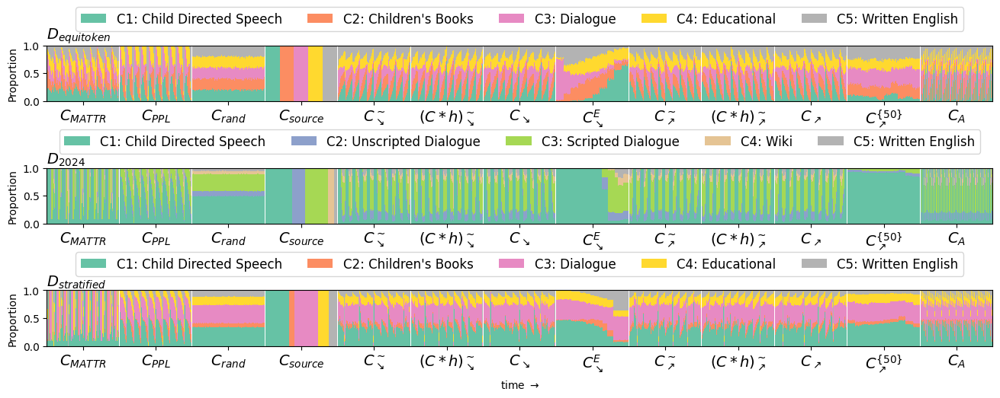

/tmp/ipykernel_3132457/724050700.py:35: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  pivot_df = data[stages + ["curriculum", "chunk"]].fillna(0)
/tmp/ipykernel_3132457/724050700.py:64: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  x_positions.extend(range(x, x + s[i]))
/tmp/ipykernel_3132457/724050700.py:65: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  x = x + s[i] + padding
/tmp/ipykernel_3132457/7

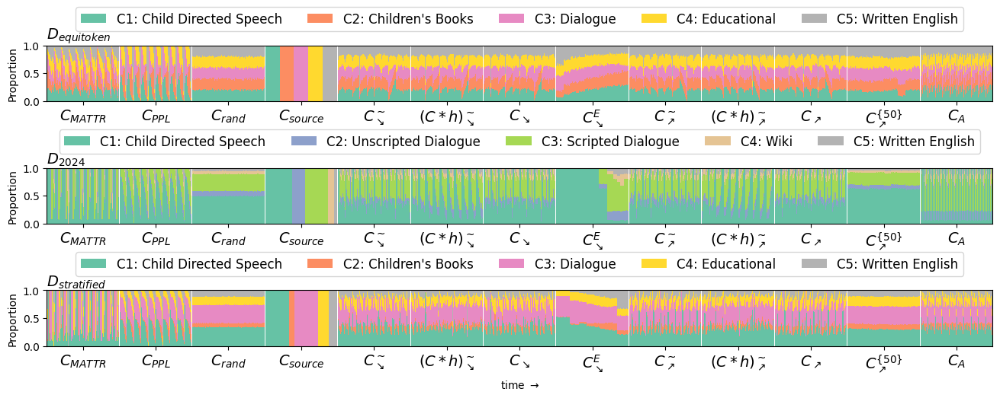

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import util
from sklearn.metrics.pairwise import cosine_similarity

def plot_proportions(model_type, skip_redundant=True):
    save_path = os.path.join("./autogenerated_figures", "source_distribution_over_time", f"{model_type}.pdf")

    norm_df = stats_df[stats_df["model_type"] == model_type].copy()

    datasets = norm_df['dataset'].unique()
    stages = sorted([c for c in norm_df.columns if "C" in c])
    left_group = ['random.pt']

    fig, axes = plt.subplots(
        len(datasets), 1,
        figsize=(16, 5),
        sharey=True,
    )

    palette = sns.color_palette("Set2")

    if len(datasets) == 1:
        axes = [axes]

    for row_idx, dataset in enumerate(datasets):
        axes[row_idx].set_title(util.rename_dataset(dataset), loc='left', fontsize=14, pad=2, fontweight='bold')

        random_df = None
        data = norm_df[norm_df['dataset'] == dataset]

        ax = axes[row_idx]

        pivot_df = data[stages + ["curriculum", "chunk"]].fillna(0)
        pivot_df = pivot_df.groupby(["curriculum", "chunk"]).mean()

        pivot_df = pivot_df.apply(lambda row: row / row.sum(), axis=1)

        pivot_df = pivot_df.loc[
                sorted(
                        pivot_df.index,
                        key=lambda idx: (
                            idx[0] not in config.baseline_curricula,  # baseline first (False < True)
                            idx[0],  # sort alphabetically by curriculum
                            idx[1]   # then by chunk
                        )
                    )
                ]


        
        s = pivot_df.groupby("curriculum").size()

        padding = 10
        bottom = pd.Series([0] * len(pivot_df), index=pivot_df.index)
        for ii, stage in enumerate(stages):
            if stage in pivot_df.columns:
                vals = pivot_df[stage]
                x_positions = []

                x = -0
                for i in range(len(s)):
                    x_positions.extend(range(x, x + s[i]))
                    x = x + s[i] + padding

                ax.bar(x_positions, vals, bottom=bottom, label=stage, width=1.0, color=palette[ii])
                bottom += vals

        ax.set_ylabel("Proportion")
        ax.set_ylim(0, 1)

        n_curricula = len(pivot_df.index.get_level_values(0).unique())
        cumulative_sum = np.cumsum(s)

        x_positions = cumulative_sum + np.arange(len(s)) * padding


        midpoints = x_positions - s / 2
        ax.set_xlim(0, x_positions[-1])
        ax.set_xticks(midpoints)
     
        ax.set_xticklabels([util.rename(i) for i in pivot_df.index.get_level_values(0).unique()], rotation=0,fontsize=14)

        a = axes[row_idx]
        handles, labels = ax.get_legend_handles_labels()
        unique_labels = []
        unique_handles = []
        for handle, label in zip(handles, labels):
            if label not in unique_labels:
                if data[label].sum() > 0:
                    unique_labels.append(label)
                    unique_handles.append(handle)
        sorted_labels_handles = sorted(zip(unique_labels, unique_handles))
        sorted_labels, sorted_handles = zip(*sorted_labels_handles)

        a.legend(
            handles=sorted_handles,
            labels=sorted_labels,
            bbox_to_anchor=(0.5, 1.8),  
            loc='upper center',
            ncol=5,
            fontsize=12,
        )
        
    axes[-1].set_xlabel(f"time $\\rightarrow$")


    plt.subplots_adjust(hspace=1.2, top=0.9) 


    plt.rcParams.update({
        "text.usetex": False,
    })
    os.makedirs(os.path.dirname(save_path), exist_ok=True)
    plt.savefig(save_path, dpi=600, bbox_inches='tight')
    plt.show()

from itertools import product
import numpy as np
for model_type in config.model_types:
    plot_proportions(model_type, skip_redundant=True)
    
